In [4]:
import contextily as cx
import dask.array as da
import geopandas as gpd
import matplotlib.pyplot as plt
import numpy as np
import planetary_computer
import rasterio as rio
from pystac_client import Client
from rasterio import transform, windows
from rasterio.enums import Resampling
from skimage.exposure import equalize_adapthist

In [15]:
# Parameter
date = "2024-05/2024-08"
modis_id = "modis-09A1-061"
landsat_id = "landsat-c2-l2"

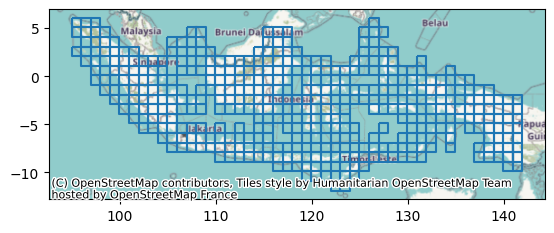

In [16]:
# Region of interest
grids = gpd.read_file(
    "https://storage.googleapis.com/gee-ramiqcom-bucket/eo-indonesia/grids.geojson",
)
ax = grids.boundary.plot()
cx.add_basemap(ax, crs="EPSG:4326")

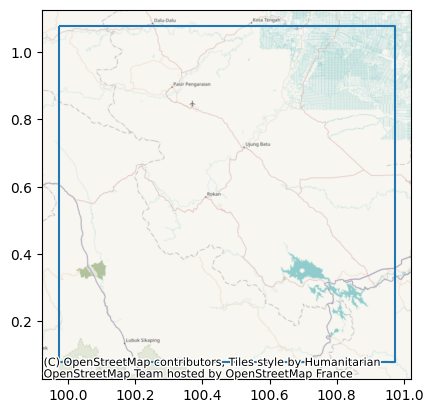

In [17]:
# Select grid no 25
grid_id = 31
roi = grids.iloc[grid_id : grid_id + 1]
ax = roi.boundary.plot()
bbox = roi.union_all().bounds
cx.add_basemap(ax, crs="EPSG:4326")

In [18]:
# Load STAC Client
client = Client.open(
    "https://planetarycomputer.microsoft.com/api/stac/v1/",
    modifier=planetary_computer.sign_inplace,
)

In [19]:
# Search for MODIS
modis_col = client.search(
    collections=[modis_id],
    datetime=date,
    bbox=bbox,
).item_collection()
modis_col

In [23]:
# Create median cloudless composite
modis_bands = [3, 4, 1, 2, 6, 7]
modis_image = []
for x in range(len(modis_col)):
    item = modis_col[x]
    assets = item.assets
    images = []

    source_qc = rio.open(assets["sur_refl_state_500m"].href)
    window = windows.from_bounds(
        *roi.to_crs(source_qc.crs).union_all().bounds,
        transform=source_qc.transform,
    )
    image_qc = source_qc.read(
        1,
        boundless=True,
        fill_value=source_qc.nodata,
        window=window,
    )
    cloud_mask = (
        ((image_qc & (1 << 1)) == 0)
        & ((image_qc & (2 << 1)) == 0)
        & ((image_qc & (3 << 1)) == 0)
        & ((image_qc & (1 << 2)) == 0)
        & ((image_qc & (1 << 8)) == 0)
        & ((image_qc & (2 << 8)) == 0)
        & ((image_qc & (3 << 8)) == 0)
        & ((image_qc & (1 << 9)) == 0)
        & ((image_qc & (2 << 9)) == 0)
        & ((image_qc & (3 << 9)) == 0)
        & ((image_qc & (1 << 10)) == 0)
        & ((image_qc & (1 << 13)) == 0)
        & ((image_qc & (1 << 14)) == 0)
    )

    for band in modis_bands:
        asset_name = f"sur_refl_b0{band}"
        source = rio.open(assets[asset_name].href)
        image = source.read(
            1,
            boundless=True,
            fill_value=source.nodata,
            window=window,
            out_dtype="float32",
        )

        image[(image == source.nodata) | ~cloud_mask] = np.nan
        image = da.from_array(image / 1e4, chunks="auto")
        images.append(image)

    modis_image.append(da.stack(images).rechunk("auto"))

modis_image = da.stack(modis_image).rechunk("auto")
modis_image = da.nanmedian(modis_image, axis=0).compute()
modis_image

array([[[0.0135    , 0.0123    , 0.0127    , ..., 0.051     ,
         0.0507    , 0.0475    ],
        [0.0111    , 0.01265   , 0.0135    , ..., 0.05175   ,
         0.04595   , 0.0487    ],
        [0.016     , 0.0133    , 0.01325   , ..., 0.05235   ,
         0.04575   , 0.04945   ],
        ...,
        [0.0082    , 0.0064    , 0.00555   , ..., 0.0261    ,
         0.027     , 0.0271    ],
        [0.0073    , 0.0063    , 0.005     , ..., 0.02785   ,
         0.02675   , 0.0255    ],
        [0.0076    , 0.0046    , 0.0041    , ..., 0.0294    ,
         0.0289    , 0.0246    ]],

       [[0.0364    , 0.0351    , 0.03665   , ..., 0.07224999,
         0.07305   , 0.07245   ],
        [0.03515   , 0.03445   , 0.037     , ..., 0.0763    ,
         0.07295   , 0.07695   ],
        [0.0371    , 0.0331    , 0.03555   , ..., 0.0782    ,
         0.07555   , 0.07655   ],
        ...,
        [0.0287    , 0.0292    , 0.02995   , ..., 0.0534    ,
         0.0556    , 0.0574    ],
        [0.0

c:\Users\ramiq\Learning\remote-sensing-python\.venv\lib\site-packages\skimage\util\dtype.py:338: RuntimeWarning: invalid value encountered in cast
  return image_out.astype(dtype_out)


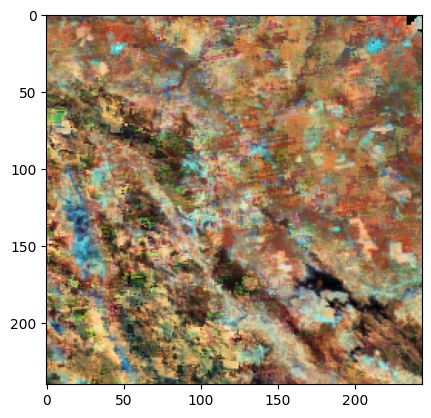

In [24]:
composite_modis = np.dstack(
    [
        equalize_adapthist(modis_image[3]),
        equalize_adapthist(modis_image[4]),
        equalize_adapthist(modis_image[5]),
    ],
)
plt.imshow(composite_modis)

In [25]:
output_image_modis = modis_image * 1e4
output_image_modis = np.nan_to_num(output_image_modis, nan=-9999)
with rio.open(
    f"temp/MODIS_Grid-{grid_id}_{date.replace('/', '_')}.tif",
    "w",
    "COG",
    count=output_image_modis.shape[0],
    width=output_image_modis.shape[2],
    height=output_image_modis.shape[1],
    compress="lzw",
    resample=Resampling.bilinear,
    nodata=-9999,
    crs="EPSG:4326",
    transform=transform.from_bounds(
        *bbox,
        width=output_image_modis.shape[2],
        height=output_image_modis.shape[1],
    ),
    dtype="int16",
) as source:
    source.write(output_image_modis)

In [26]:
# Landsat client
client = Client.open(
    "https://planetarycomputer.microsoft.com/api/stac/v1/",
    modifier=planetary_computer.sign_inplace,
)

In [27]:
# Search for Landsat
landsat_col = client.search(
    collections=[landsat_id],
    datetime=date,
    bbox=bbox,
    query={"landsat:collection_category": {"eq": "T1"}},
).item_collection()
landsat_col

In [28]:
# Create median cloudless composite
landsat_bands = ["blue", "green", "red", "nir08", "swir16", "swir22"]
landsat_image = []
for x in range(len(landsat_col)):
    item = landsat_col[x]
    print(f"Processing: {item.id}")
    assets = item.assets
    images = []

    qa_source = rio.open(assets["qa_pixel"].href)
    window = windows.from_bounds(
        *roi.to_crs(qa_source.crs).union_all().bounds,
        transform=qa_source.transform,
    )
    qa_image = qa_source.read(
        1,
        boundless=True,
        fill_value=qa_source.nodata,
        window=window,
    )
    cloud_mask = (
        ((qa_image & (1 << 1)) == 0)
        & ((qa_image & (1 << 2)) == 0)
        & ((qa_image & (1 << 3)) == 0)
        & ((qa_image & (1 << 4)) == 0)
    )

    for band in landsat_bands:
        source = rio.open(assets[band].href)
        image = source.read(
            1,
            boundless=True,
            fill_value=source.nodata,
            window=window,
            out_dtype="float32",
        )

        image[(image == source.nodata) | ~cloud_mask] = np.nan
        image = da.from_array(image * 0.0000275 - 0.2, chunks="auto")
        images.append(image)

    landsat_image.append(da.stack(images).rechunk("auto"))

landsat_image = da.stack(landsat_image).rechunk("auto")
landsat_image = da.nanmedian(landsat_image, axis=0).compute()
landsat_image

Processing: LC08_L2SP_127060_20240826_02_T1
Processing: LC08_L2SP_127059_20240826_02_T1
Processing: LC09_L2SP_128060_20240825_02_T1
Processing: LC09_L2SP_128059_20240825_02_T1
Processing: LC09_L2SP_127060_20240818_02_T1
Processing: LC09_L2SP_127059_20240818_02_T1
Processing: LC08_L2SP_128060_20240817_02_T1
Processing: LC08_L2SP_128059_20240817_02_T1
Processing: LC09_L2SP_128060_20240809_02_T1
Processing: LC09_L2SP_128059_20240809_02_T1
Processing: LC09_L2SP_127060_20240802_02_T1
Processing: LC09_L2SP_127059_20240802_02_T1
Processing: LC08_L2SP_128060_20240801_02_T1
Processing: LC08_L2SP_128059_20240801_02_T1
Processing: LC08_L2SP_127060_20240725_02_T1
Processing: LC08_L2SP_127059_20240725_02_T1
Processing: LC09_L2SP_128060_20240724_02_T1
Processing: LC09_L2SP_128059_20240724_02_T1
Processing: LC09_L2SP_127060_20240717_02_T1
Processing: LC09_L2SP_127059_20240717_02_T1
Processing: LC08_L2SP_128060_20240716_02_T1
Processing: LC08_L2SP_128059_20240716_02_T1
Processing: LC09_L2SP_128059_202

array([[[0.0188725 , 0.02096249, 0.019835  , ..., 0.04611125,
         0.04866875, 0.04891625],
        [0.017965  , 0.020165  , 0.0200275 , ..., 0.04272875,
         0.04608375, 0.04836626],
        [0.01650749, 0.02121   , 0.02028875, ..., 0.039085  ,
         0.04033625, 0.04096875],
        ...,
        [0.011805  , 0.01455499, 0.01880375, ..., 0.0187625 ,
         0.0190925 , 0.0188725 ],
        [0.0110075 , 0.01219   , 0.01187374, ..., 0.0181025 ,
         0.019945  , 0.0188175 ],
        [0.01449999, 0.011145  , 0.0112    , ..., 0.02107249,
         0.02052251, 0.01878999]],

       [[0.0533575 , 0.04758249, 0.0448325 , ..., 0.06472875,
         0.06503126, 0.06668125],
        [0.04573999, 0.046455  , 0.0460425 , ..., 0.06284499,
         0.06566374, 0.06884   ],
        [0.0452175 , 0.04791249, 0.0471425 , ..., 0.05469126,
         0.05540626, 0.06052125],
        ...,
        [0.0308625 , 0.03949749, 0.04649625, ..., 0.039635  ,
         0.0407625 , 0.039195  ],
        [0.0

c:\Users\ramiq\Learning\remote-sensing-python\.venv\lib\site-packages\skimage\util\dtype.py:338: RuntimeWarning: invalid value encountered in cast
  return image_out.astype(dtype_out)


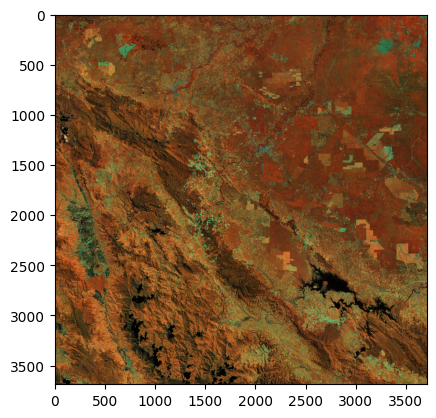

In [29]:
composite_landsat = np.dstack(
    [
        equalize_adapthist(landsat_image[3]),
        equalize_adapthist(landsat_image[4]),
        equalize_adapthist(landsat_image[5]),
    ],
)
plt.imshow(composite_landsat)

In [30]:
output_image_landsat = landsat_image * 1e4
output_image_landsat = np.nan_to_num(output_image_landsat, nan=-9999)
with rio.open(
    f"temp/Landsat_Grid-{grid_id}_{date.replace('/', '_')}.tif",
    "w",
    "COG",
    count=output_image_landsat.shape[0],
    width=output_image_landsat.shape[2],
    height=output_image_landsat.shape[1],
    compress="lzw",
    resample=Resampling.bilinear,
    nodata=-9999,
    crs="EPSG:4326",
    transform=transform.from_bounds(
        *bbox,
        width=output_image_landsat.shape[2],
        height=output_image_landsat.shape[1],
    ),
    dtype="int16",
) as source:
    source.write(output_image_landsat)